In [1]:
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
from scipy.integrate import solve_ivp
from mpl_toolkits.mplot3d.art3d import Line3DCollection
from matplotlib.collections import LineCollection
from matplotlib.colors import LinearSegmentedColormap

In [2]:
color_gradients = ["#16A085", "#F4D03F"]

In [3]:
def get_lorenz_config(index):
    """
    Get Lorenz system parameters by configuration index.
    
    Parameters:
    - index: int (0-5), configuration index
    
    Returns:
    - tuple: (sigma, rho, beta, description)
    """
    configs = [
        (10.0, 28.0, 8.0/3.0, "Classic ($\\sigma$=10, $\\rho$=28, $\\beta$=8/3)"),
        (10.0, 24.0, 8.0/3.0, "Compressed ($\\sigma$=10, $\\rho$=24, $\\beta$=8/3)"),
        (10.0, 35.0, 8.0/3.0, "Extended ($\\sigma$=10, $\\rho$=35, $\\beta$=8/3)"),
        (16.0, 45.6, 4.0, "Alternative ($\\sigma$=16, $\\rho$=45.6, $\\beta$=4)"),
        (10.0, 28.0, 2.0, "Tight Spiral ($\\sigma$=10, $\\rho$=28, $\\beta$=2)"),
        (8.0, 30.0, 3.0, "Loose ($\\sigma$=8, $\\rho$=30, $\\beta$=3)")
    ]
    
    if 0 <= index < len(configs):
        return configs[index]
    else:
        raise ValueError(f"Index must be between 0 and {len(configs)-1}")

def solve_lorenz_config(index, t_span=(0, 100), n_points=10000, state0=[1.0, 1.0, 1.0]):
    """
    Solve Lorenz system for a specific configuration.
    
    Parameters:
    - index: int, configuration index (0-5)
    - t_span: tuple, time span for integration
    - n_points: int, number of time points
    - state0: list, initial conditions
    
    Returns:
    - sol: scipy solution object
    - description: str, configuration description
    """
    sigma, rho, beta, description = get_lorenz_config(index)
    
    def lorenz_local(t, state):
        x, y, z = state
        dxdt = sigma * (y - x)
        dydt = x * (rho - z) - y
        dzdt = x * y - beta * z
        return [dxdt, dydt, dzdt]
    
    t_eval = np.linspace(*t_span, n_points)
    sol = solve_ivp(lorenz_local, t_span, state0, t_eval=t_eval)
    
    return sol, description

In [4]:
# Create custom colormap from your gradient colors
colors = color_gradients
custom_cmap = LinearSegmentedColormap.from_list("custom", colors)

In [5]:

def _extract_data(data):
    """
    Helper function to extract time and coordinates from either scipy solution or raw arrays.
    
    Parameters:
    - data: either scipy solution object or tuple/list of (t, x, y, z)
    
    Returns:
    - t, x, y, z: numpy arrays
    """
    if hasattr(data, 'y') and hasattr(data, 't'):
        # scipy solution object
        t = data.t
        x, y, z = data.y[0], data.y[1], data.y[2]
    elif isinstance(data, (tuple, list)) and len(data) >= 4:
        # Raw arrays (t, x, y, z) or (t, x, y, z, ...)
        t, x, y, z = data[0], data[1], data[2], data[3]
    else:
        raise ValueError("Data must be either scipy solution object or tuple/list of (t, x, y, z)")
    
    return t, x, y, z

def plot_3d_trajectory(data, title="3D Trajectory", view_angle=(15, 60), 
                      figsize=(12, 10), colormap="custom", show_colorbar=True,
                      linewidth=1.2, alpha=0.8, save_path=None, show_title=True):
    """
    Plot 3D trajectory from either scipy solution or raw coordinates.
    
    Parameters:
    - data: scipy solution object or tuple/list of (t, x, y, z)
    - title: plot title
    - view_angle: tuple of (elevation, azimuth) for 3D view
    - figsize: figure size tuple
    - colormap: colormap name or "custom" for purple-to-teal gradient
    - show_colorbar: whether to show colorbar
    - linewidth: line width for trajectory
    - alpha: transparency
    - save_path: optional path to save figure
    
    Returns:
    - fig: matplotlib figure object
    """
    
    # Extract data
    t, x, y, z = _extract_data(data)
    
    # Set up colormap
    if colormap == "custom":
        color_gradients = ["#CC95C0", "#DBD4B4", "#7AA1D2"]
        cmap = LinearSegmentedColormap.from_list("custom", color_gradients)
    else:
        cmap = colormap
    
    # Create figure
    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111, projection='3d')
    
    # Create line collection with time-based colors
    points = np.array([x, y, z]).T.reshape(-1, 1, 3)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)
    lc = Line3DCollection(segments, cmap=cmap, linewidths=linewidth, alpha=alpha)
    lc.set_array(t[:-1])
    
    # Add to plot
    line = ax.add_collection3d(lc, zs=None, zdir='z')
    
    # Set axis limits explicitly to ensure data fills the plot
    ax.set_xlim(x.min(), x.max())
    ax.set_ylim(y.min(), y.max())
    ax.set_zlim(z.min(), z.max())
    
    # Adjust subplot position to fill more of the figure (reduce whitespace)
    ax.set_position([0, 0, 1, 1])  # [left, bottom, width, height]
    
    # Clean up axes
    ax.grid(False)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_zticks([])
    ax.xaxis.pane.fill = False
    ax.yaxis.pane.fill = False
    ax.zaxis.pane.fill = False
    ax.xaxis.pane.set_alpha(0)
    ax.yaxis.pane.set_alpha(0)
    ax.zaxis.pane.set_alpha(0)
    
    # Remove axis lines
    ax.xaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
    ax.yaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
    ax.zaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
    
    # Set viewing angle
    ax.view_init(elev=view_angle[0], azim=view_angle[1])
    
    # Add colorbar
    if show_colorbar:
        cbar = plt.colorbar(line, ax=ax, shrink=0.6, aspect=30, pad=0.1)
        cbar.set_label('Time', rotation=270, labelpad=20, fontsize=12)
    
    if show_title:
        plt.title(title, fontsize=16, pad=20)
    
    # Don't use tight_layout with manual positioning
    # plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, bbox_inches='tight', pad_inches=0)
    
    plt.show()
    
    return fig


def plot_2d_projections(data, show_labels=True, show_titles=True, show_ticks=False,
                       show_colorbar=True, show_main_title=True, main_title="2D Projections",
                       figsize=(20, 8), colormap="custom", linewidth=1.0, alpha=0.8,
                       save_path=None, save_subplots_dir=None):
    """
    Plot 2D projections from either scipy solution or raw coordinates.

    Parameters:
    - data: scipy solution object or tuple/list of (t, x, y, z)
    - show_labels: whether to show axis labels
    - show_titles: whether to show subplot titles
    - show_ticks: whether to show axis ticks
    - show_colorbar: whether to show colorbar
    - show_main_title: whether to show main title
    - main_title: main title text
    - figsize: figure size tuple
    - colormap: colormap name or "custom" for purple-to-teal gradient
    - linewidth: line width
    - alpha: transparency
    - save_path: optional path to save combined figure
    - save_subplots_dir: optional directory path; if provided, saves each subplot as a separate SVG file
    Returns:
    - fig: matplotlib figure object
    """
    # Extract data
    t, x, y, z = _extract_data(data)

    # Set up colormap
    if colormap == "custom":
        color_gradients = ["#CC95C0", "#DBD4B4", "#7AA1D2"]
        cmap = LinearSegmentedColormap.from_list("custom", color_gradients)
    else:
        cmap = colormap

    # Create figure
    fig, axes = plt.subplots(1, 3, figsize=figsize)

    # Define projections
    projections = [
        (x, y, 'X', 'Y', 'X-Y Projection'),
        (x, z, 'X', 'Z', 'X-Z Projection'),
        (y, z, 'Y', 'Z', 'Y-Z Projection')
    ]

    for i, (x_data, y_data, x_label, y_label, title) in enumerate(projections):
        # Create line collection
        points = np.array([x_data, y_data]).T.reshape(-1, 1, 2)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)
        lc = LineCollection(segments, cmap=cmap, linewidths=linewidth, alpha=alpha)
        lc.set_array(t[:-1])

        # Add to plot
        axes[i].add_collection(lc)
        axes[i].set_xlim(x_data.min(), x_data.max())
        axes[i].set_ylim(y_data.min(), y_data.max())

        # Remove the square boxes (spines)
        for spine in axes[i].spines.values():
            spine.set_visible(False)

        # Optional elements
        if show_labels:
            axes[i].set_xlabel(x_label, fontsize=12)
            axes[i].set_ylabel(y_label, fontsize=12)
        if show_titles:
            axes[i].set_title(title, fontsize=14)
        if not show_ticks:
            axes[i].set_xticks([])
            axes[i].set_yticks([])

    # Optional colorbar
    if show_colorbar:
        cbar = fig.colorbar(lc, ax=axes, shrink=0.6, aspect=30)
        cbar.set_label('Time', rotation=270, labelpad=20, fontsize=12)

    # Optional main title
    if show_main_title:
        plt.suptitle(main_title, fontsize=16, y=1.02)

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')

    # Save each subplot individually as SVG if requested
    if save_subplots_dir is not None:
        import os
        os.makedirs(save_subplots_dir, exist_ok=True)
        # Ensure the renderer is available
        fig.canvas.draw()
        for i, ax in enumerate(axes):
            bbox = ax.get_tightbbox(fig.canvas.get_renderer()).transformed(fig.dpi_scale_trans.inverted())
            safe_title = main_title.replace(" ", "_")
            fname = os.path.join(save_subplots_dir, f"{safe_title}_subplot_{i+1}.svg")
            fig.savefig(fname, bbox_inches=bbox, format="svg")

    if save_path is None and save_subplots_dir is None:
        # Only show interactively when not saving (keeps previous behavior)
        plt.show()

    return fig


def plot_2d_projection_single(data, projection_index=0, show_labels=False, show_title=False, 
                               show_ticks=False, show_colorbar=False, title=None,
                               figsize=(8, 8), colormap="custom", linewidth=1.0, alpha=0.8,
                               save_path=None):
    """
    Plot a single 2D projection from either scipy solution or raw coordinates.

    Parameters:
    - data: scipy solution object or tuple/list of (t, x, y, z)
    - projection_index: int (0, 1, or 2) - 0: X-Y, 1: X-Z, 2: Y-Z
    - show_labels: whether to show axis labels
    - show_title: whether to show title
    - show_ticks: whether to show axis ticks
    - show_colorbar: whether to show colorbar
    - title: custom title text (if None, uses default based on projection)
    - figsize: figure size tuple
    - colormap: colormap name or "custom" for purple-to-teal gradient
    - linewidth: line width
    - alpha: transparency
    - save_path: optional path to save figure
    
    Returns:
    - fig: matplotlib figure object
    """
    # Extract data
    t, x, y, z = _extract_data(data)

    # Set up colormap
    if colormap == "custom":
        color_gradients = ["#CC95C0", "#DBD4B4", "#7AA1D2"]
        cmap = LinearSegmentedColormap.from_list("custom", color_gradients)
    else:
        cmap = colormap

    # Define projections
    projections = [
        (x, y, 'X', 'Y', 'X-Y Projection'),
        (x, z, 'X', 'Z', 'X-Z Projection'),
        (y, z, 'Y', 'Z', 'Y-Z Projection')
    ]
    
    # Validate projection index
    if not 0 <= projection_index <= 2:
        raise ValueError("projection_index must be 0 (X-Y), 1 (X-Z), or 2 (Y-Z)")
    
    # Get the selected projection
    x_data, y_data, x_label, y_label, default_title = projections[projection_index]
    
    # Use custom title if provided, otherwise use default
    plot_title = title if title is not None else default_title

    # Create figure
    fig, ax = plt.subplots(1, 1, figsize=figsize)

    # Create line collection
    points = np.array([x_data, y_data]).T.reshape(-1, 1, 2)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)
    lc = LineCollection(segments, cmap=cmap, linewidths=linewidth, alpha=alpha)
    lc.set_array(t[:-1])

    # Add to plot
    ax.add_collection(lc)
    ax.set_xlim(x_data.min(), x_data.max())
    ax.set_ylim(y_data.min(), y_data.max())

    # Remove the square boxes (spines)
    for spine in ax.spines.values():
        spine.set_visible(False)

    # Optional elements
    if show_labels:
        ax.set_xlabel(x_label, fontsize=12)
        ax.set_ylabel(y_label, fontsize=12)
    if show_title:
        ax.set_title(plot_title, fontsize=14)
    if not show_ticks:
        ax.set_xticks([])
        ax.set_yticks([])

    # Optional colorbar
    if show_colorbar:
        cbar = fig.colorbar(lc, ax=ax, shrink=0.6, aspect=30)
        cbar.set_label('Time', rotation=270, labelpad=20, fontsize=12)

    plt.tight_layout()

    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
        plt.close(fig)  # Close to free memory when saving
    else:
        plt.show()

    return fig


def plot_multiple_viewing_angles(data, title="Multiple Viewing Angles", 
                                figsize=(16, 12), colormap="custom", save_path=None, set_title=False, show_axes=False):
    """
    Plot 3D trajectory from multiple viewing angles.
    
    Parameters:
    - data: scipy solution object or tuple/list of (t, x, y, z)
    - title: main title
    - figsize: figure size tuple
    - colormap: colormap name or "custom" for purple-to-teal gradient
    - save_path: optional path to save figure
    
    Returns:
    - fig: matplotlib figure object
    """
    
    # Extract data
    t, x, y, z = _extract_data(data)
    
    # Set up colormap
    if colormap == "custom":
        color_gradients = ["#CC95C0", "#DBD4B4", "#7AA1D2"]
        cmap = LinearSegmentedColormap.from_list("custom", color_gradients)
    else:
        cmap = colormap
    
    # Define viewing angles
    viewing_angles = [
        (15, 60, "Classic View"),
        (10, 0, "Side View"), 
        (85, 0, "Top View"),
        (25, 120, "Angled View"),
        (5, 270, "Front View"),
        (30, 210, "Perspective View")
    ]
    
    fig = plt.figure(figsize=figsize)
    
    for i, (elev, azim, subtitle) in enumerate(viewing_angles):
        ax = fig.add_subplot(2, 3, i+1, projection='3d')
        
        # Create line collection
        points = np.array([x, y, z]).T.reshape(-1, 1, 3)
        segments = np.concatenate([points[:-1], points[1:]], axis=1)
        lc = Line3DCollection(segments, cmap=cmap, linewidths=1.0, alpha=0.8)
        lc.set_array(t[:-1])
        
        # Add to plot
        ax.add_collection3d(lc, zs=None, zdir='z')
        
        # Clean up axes
        ax.grid(False)
        ax.set_xticks([])
        ax.set_yticks([])
        ax.set_zticks([])
        ax.xaxis.pane.fill = False
        ax.yaxis.pane.fill = False
        ax.zaxis.pane.fill = False
        ax.xaxis.pane.set_alpha(0)
        ax.yaxis.pane.set_alpha(0)
        ax.zaxis.pane.set_alpha(0)
        
        # Optional: Hide axis lines completely
        if not show_axes:
            ax.xaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
            ax.yaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
            ax.zaxis.line.set_color((1.0, 1.0, 1.0, 0.0))
            # Make axes completely invisible
            ax.set_axis_off()
        
        # Set viewing angle
        ax.view_init(elev=elev, azim=azim)
        if set_title:
            ax.set_title(subtitle, fontsize=12)
    
    plt.tight_layout()
    if set_title:
        plt.suptitle(title, fontsize=16, y=0.98)
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
    
    plt.show()
    
    return fig


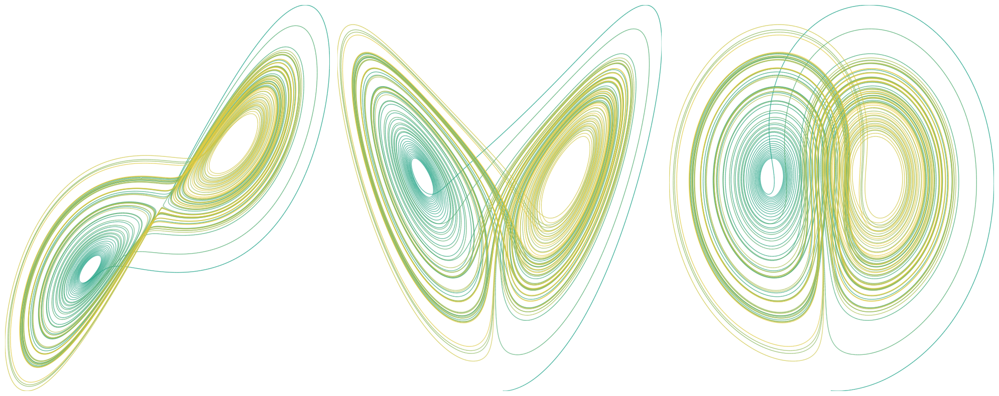

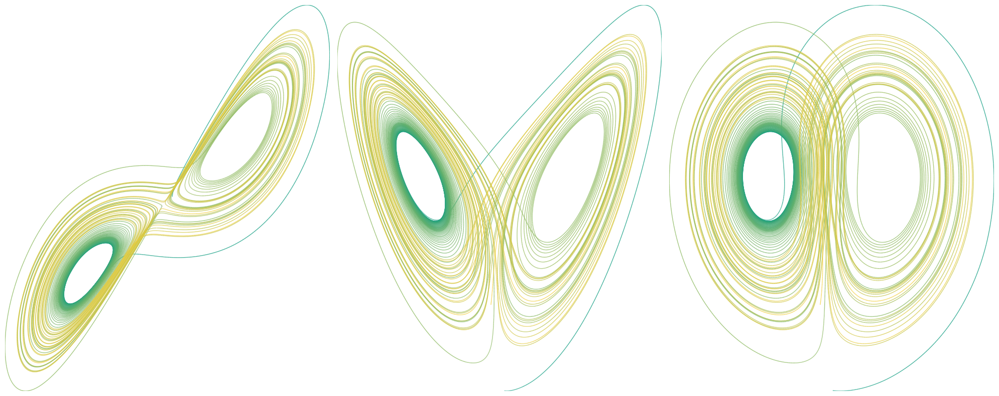

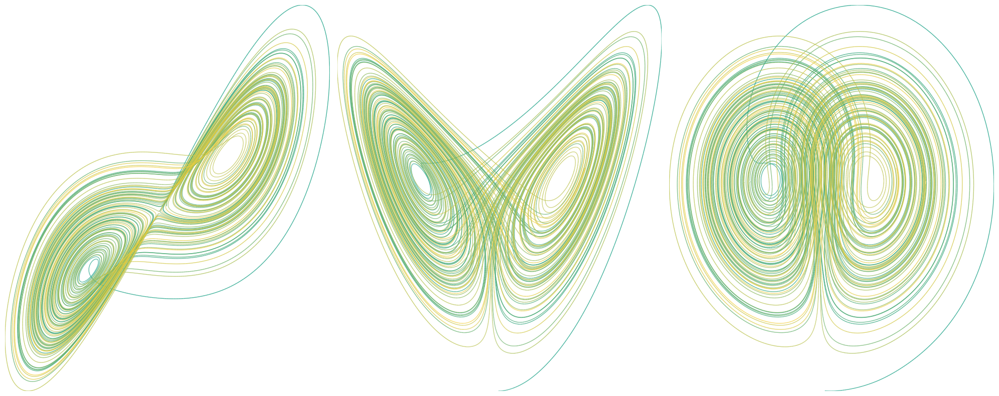

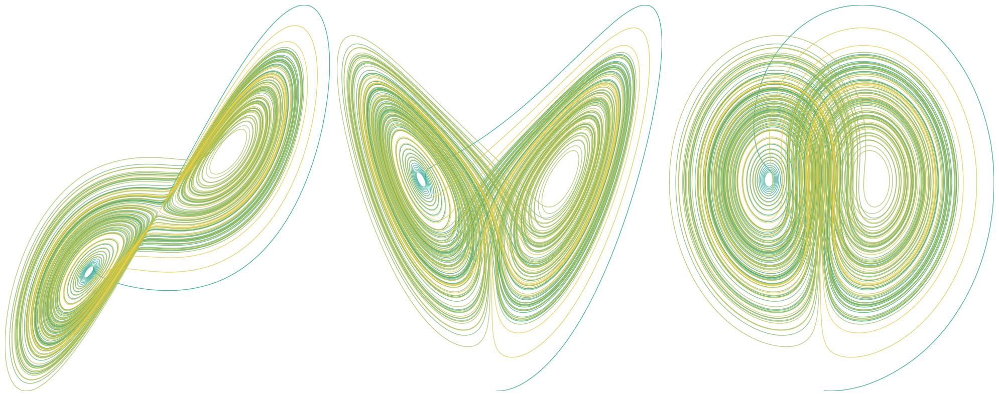

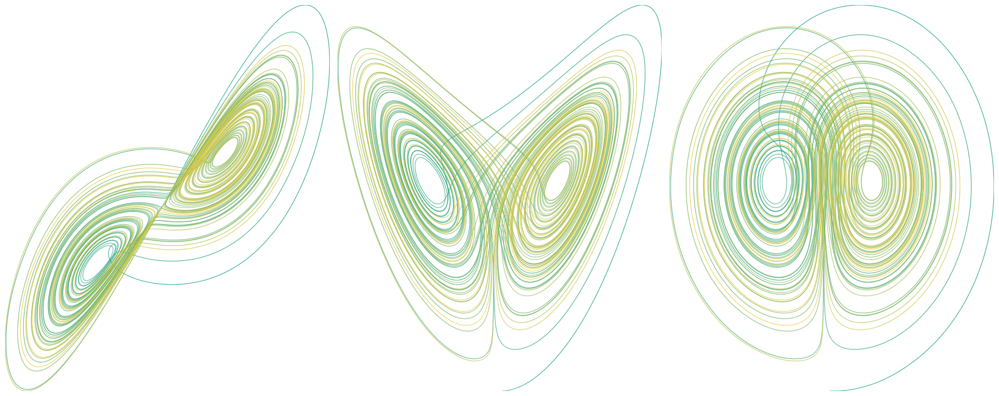

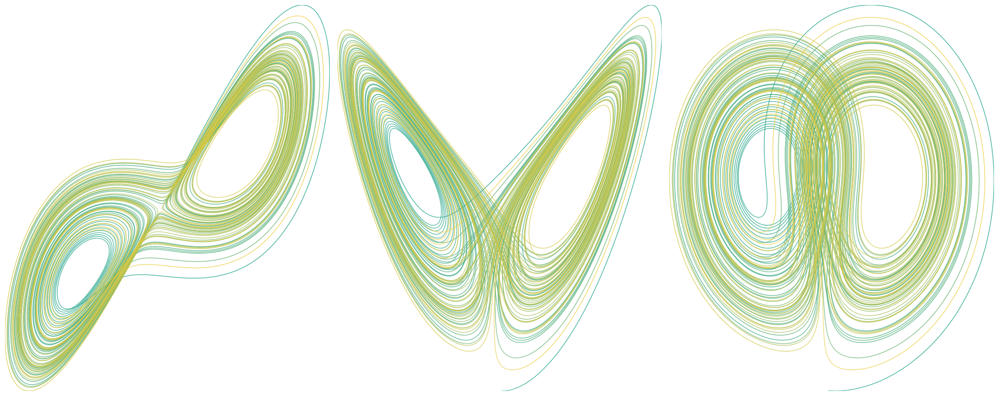

In [6]:
for i in range(0, 6, 1):
    sol , descr = solve_lorenz_config(index=i, t_span=(0, 100), n_points=50000, state0=[1.0, 1.0, 1.0])
    _ = plot_2d_projections(sol, show_labels=False, show_titles=False,  colormap=custom_cmap, show_colorbar=False, show_main_title=False)

In [7]:
def stochastic_lorenz_euler_maruyama(sigma, rho, beta, 
                                     D, 
                                     t_span, dt,
                                     state0
                                     ):
    """
    Solve stochastic Lorenz system using Euler-Maruyama method.
    
    Stochastic Lorenz equations:
    dx = \\sigma(y - x) dt + \\sqrt{2D} dW_t^{(x)}
    dy = (x(\\rho - z) - y) dt + \\sqrt{2D} dW_t^{(y)}
    dz = (xy - \\beta z) dt + \\sqrt{2D} dW_t^{(z)}
    
    where dW_t^{(i)} are independent Brownian increments.
    """
    
    # Time grid
    t = np.arange(t_span[0], t_span[1], dt)
    n_steps = len(t)
    
    # Initialize arrays
    x = np.zeros(n_steps)
    y = np.zeros(n_steps)
    z = np.zeros(n_steps)
    
    # Initial conditions
    x[0], y[0], z[0] = state0
    
    # Noise coefficient
    noise_coeff = np.sqrt(2.0 * D * dt)
    
    for i in range(1, n_steps):
        # Current state
        x_curr, y_curr, z_curr = x[i-1], y[i-1], z[i-1]
        
        # Deterministic terms
        dx_det = sigma * (y_curr - x_curr) * dt
        dy_det = (x_curr * (rho - z_curr) - y_curr) * dt
        dz_det = (x_curr * y_curr - beta * z_curr) * dt
        
        # Stochastic terms (Gaussin white noise)
        dx_stoch = noise_coeff * np.random.normal()
        dy_stoch = noise_coeff * np.random.normal()  
        dz_stoch = noise_coeff * np.random.normal()
        
        # Update state
        x[i] = x_curr + dx_det + dx_stoch
        y[i] = y_curr + dy_det + dy_stoch
        z[i] = z_curr + dz_det + dz_stoch
    
    return t, x, y, z

def stochastic_lorenz_multiplicative(sigma, rho, beta,
                                     D, 
                                     t_span, dt,
                                     state0
                                     ):
    """
    Stochastic Lorenz with state-dependent (multiplicative) noise.
    
    dx = \\sigma(y - x) dt + x \\cdot \\sqrt{2D} dW_t^{(x)}
    dy = (x(\\rho - z) - y) dt + y \\cdot \\sqrt{2D} dW_t^{(y)}
    dz = (xy - \\beta z) dt + z \\cdot \\sqrt{2D} dW_t^{(z)}
    """
    
    t = np.arange(t_span[0], t_span[1], dt)
    n_steps = len(t)
    
    x = np.zeros(n_steps)
    y = np.zeros(n_steps)
    z = np.zeros(n_steps)
    
    x[0], y[0], z[0] = state0
    noise_coeff = np.sqrt(2.0 * D * dt)
    
    for i in range(1, n_steps):
        x_curr, y_curr, z_curr = x[i-1], y[i-1], z[i-1]
        
        # Deterministic terms
        dx_det = sigma * (y_curr - x_curr) * dt
        dy_det = (x_curr * (rho - z_curr) - y_curr) * dt
        dz_det = (x_curr * y_curr - beta * z_curr) * dt
        
        # Multiplicative noise terms
        dx_stoch = noise_coeff * x_curr * np.random.normal()
        dy_stoch = noise_coeff * y_curr * np.random.normal()
        dz_stoch = noise_coeff * z_curr * np.random.normal()
        
        x[i] = x_curr + dx_det + dx_stoch
        y[i] = y_curr + dy_det + dy_stoch
        z[i] = z_curr + dz_det + dz_stoch
    
    return t, x, y, z


def lorenz_with_ou_noise(sigma, rho, beta,
                         D, correlation_time,
                         t_span, dt,
                         state0
                         ):
    """
    Lorenz system with Ornstein-Uhlenbeck colored noise.
    
    The OU noise process:
    d\\eta_i = -(1/\\tau) \\eta_i dt + \\sqrt{2D/\\tau} dW_t
    
    Autocorrelation: E[\\eta(t) \\eta(t')] = D \\cdot exp(-|t-t'|/\\tau)
    Stationary distribution: \\eta_i ~ N(0, D)
    """
    
    t = np.arange(t_span[0], t_span[1], dt)
    n_steps = len(t)
    
    # System state
    x = np.zeros(n_steps)
    y = np.zeros(n_steps)
    z = np.zeros(n_steps)
    
    # OU noise processes
    eta_x = np.zeros(n_steps)
    eta_y = np.zeros(n_steps) 
    eta_z = np.zeros(n_steps)
    
    x[0], y[0], z[0] = state0
    
    # OU parameters
    theta = 1.0 / correlation_time  # Damping coefficient
    
    for i in range(1, n_steps):
        # Current state
        x_curr, y_curr, z_curr = x[i-1], y[i-1], z[i-1]
        eta_x_curr, eta_y_curr, eta_z_curr = eta_x[i-1], eta_y[i-1], eta_z[i-1]
        
        # Update OU noise processes
        dW_x = np.random.normal() * np.sqrt(dt)
        dW_y = np.random.normal() * np.sqrt(dt)
        dW_z = np.random.normal() * np.sqrt(dt)
        
        eta_x[i] = eta_x_curr - theta * eta_x_curr * dt + np.sqrt(2.0 * D * theta) * dW_x
        eta_y[i] = eta_y_curr - theta * eta_y_curr * dt + np.sqrt(2.0 * D * theta) * dW_y
        eta_z[i] = eta_z_curr - theta * eta_z_curr * dt + np.sqrt(2.0 * D * theta) * dW_z
        
        # Lorenz dynamics with colored noise
        dx = (sigma * (y_curr - x_curr) + eta_x[i]) * dt
        dy = (x_curr * (rho - z_curr) - y_curr + eta_y[i]) * dt
        dz = (x_curr * y_curr - beta * z_curr + eta_z[i]) * dt
        
        x[i] = x_curr + dx
        y[i] = y_curr + dy
        z[i] = z_curr + dz
    
    return t, x, y, z, eta_x, eta_y, eta_z

In [8]:
# Parameters
sigma, rho, beta = 10.0, 28.0, 8.0/3.0
dt = 0.001
t_span = (0, 100)
state0 = [1.0, 1.0, 1.0]

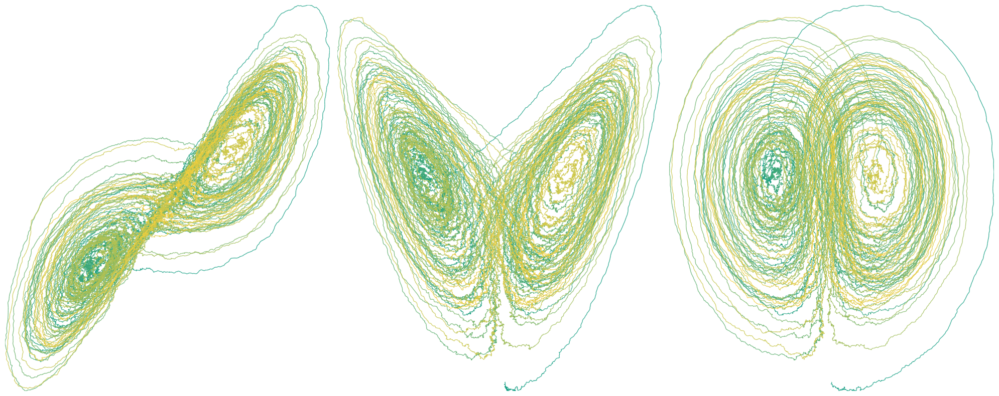

In [9]:
D = 2.0  # Noise intensity
t, x, y, z = stochastic_lorenz_euler_maruyama(sigma, rho, beta, D, 
                                              t_span, dt, state0)

_ = plot_2d_projections((t, x, y, z),
                        show_labels=False, show_titles=False,  show_colorbar=False, show_main_title=False, 
                        main_title="Stochastic Lorenz System Projections",
                        figsize=(20, 8), colormap=custom_cmap, linewidth=1.0, alpha=0.8, save_path=None
                        )

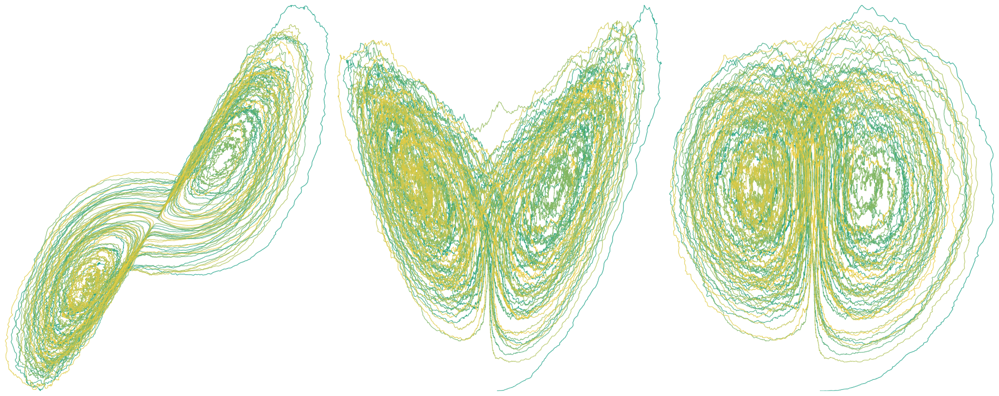

In [10]:
D = 0.02  # Noise intensity
t, x, y, z = stochastic_lorenz_multiplicative(sigma, rho, beta, D, 
                                              t_span, dt, state0)

_ = plot_2d_projections((t, x, y, z),
                        show_labels=False, show_titles=False,  show_colorbar=False, show_main_title=False, 
                        main_title="Stochastic Lorenz System Projections",
                        figsize=(20, 8), colormap=custom_cmap, linewidth=1.0, alpha=0.8, save_path=None
                        )

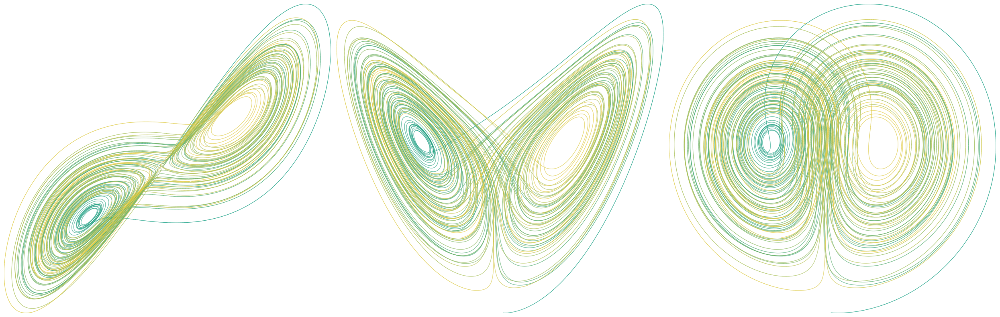

In [11]:
D = 5.0
correlation_time = 5.0

t, x, y, z, eta_x, eta_y, eta_z = lorenz_with_ou_noise(sigma, rho, beta, 
                                  D=D, 
                                  correlation_time=correlation_time,
                                  t_span=t_span, dt=dt, state0=state0)

_ = plot_2d_projections((t, x, y, z),
                        show_labels=False, show_titles=False,  show_colorbar=False, show_main_title=False, 
                        main_title="Stochastic Lorenz System Projections",
                        figsize=(25, 8), colormap=custom_cmap, linewidth=1.0, alpha=0.8, save_path=None,
                        save_subplots_dir="./figures/lorenz_ou_noise_projections_moreRandom_v2"
                        )

In [12]:
data = (t, x, y, z, eta_x, eta_y, eta_z)

In [13]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots


def plot_interactive_3d_lorenz(data, title="Interactive 3D Lorenz Attractor", 
                               color_scale='Viridis', custom_colors=None,
                               width=1000, height=800, show_colorbar=True):
    """
    Create an interactive 3D plot of the Lorenz attractor using Plotly.
    
    Parameters:
    - data: scipy solution object or tuple/list of (t, x, y, z, ...)
    - title: plot title
    - color_scale: Plotly colorscale name ('Viridis', 'Plasma', 'Turbo', 'Rainbow')
    - custom_colors: list of hex colors for custom gradient, e.g., ["#16A085", "#F4D03F"]
    - width: figure width in pixels
    - height: figure height in pixels
    - show_colorbar: whether to show colorbar
    """
    # Extract data
    if hasattr(data, 'y'):
        x, y, z = data.y[0], data.y[1], data.y[2]
        t = data.t
    else:
        # Handle both (t, x, y, z) and (t, x, y, z, eta_x, eta_y, eta_z)
        t, x, y, z = data[0], data[1], data[2], data[3]
    
    # Create color based on time
    colors = np.linspace(0, 1, len(t))
    
    # Convert custom_colors to Plotly colorscale format if provided
    if custom_colors is not None:
        n_colors = len(custom_colors)
        plotly_colorscale = [
            [i / (n_colors - 1), color] 
            for i, color in enumerate(custom_colors)
        ]
    else:
        plotly_colorscale = color_scale
    
    # Create 3D scatter trace
    fig = go.Figure(data=[go.Scatter3d(
        x=x, y=y, z=z,
        mode='lines',
        line=dict(
            color=colors,
            colorscale=plotly_colorscale,
            width=2,
            colorbar=dict(title="Time", thickness=20, len=0.7) if show_colorbar else None,
            showscale=show_colorbar
        ),
        hovertemplate='<b>X</b>: %{x:.2f}<br><b>Y</b>: %{y:.2f}<br><b>Z</b>: %{z:.2f}<extra></extra>'
    )])
    
    # Update layout
    fig.update_layout(
        title=dict(text=title, x=0.5, xanchor='center'),
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            camera=dict(eye=dict(x=1.5, y=1.5, z=1.3)),
            aspectmode='cube'
        ),
        width=width,
        height=height,
        showlegend=False
    )
    
    return fig

# Usage with your custom colors
fig = plot_interactive_3d_lorenz(data, custom_colors=color_gradients, show_colorbar=False)
fig.show()

In [14]:
viewing_angles = [
        (15, 60, "Classic View"),
        (15, 70, "Angled View"),
        (15, 80, "Front View"),
        (15, 90, "Perspective View"),
        (20, 60, "Classic View"),
    ]

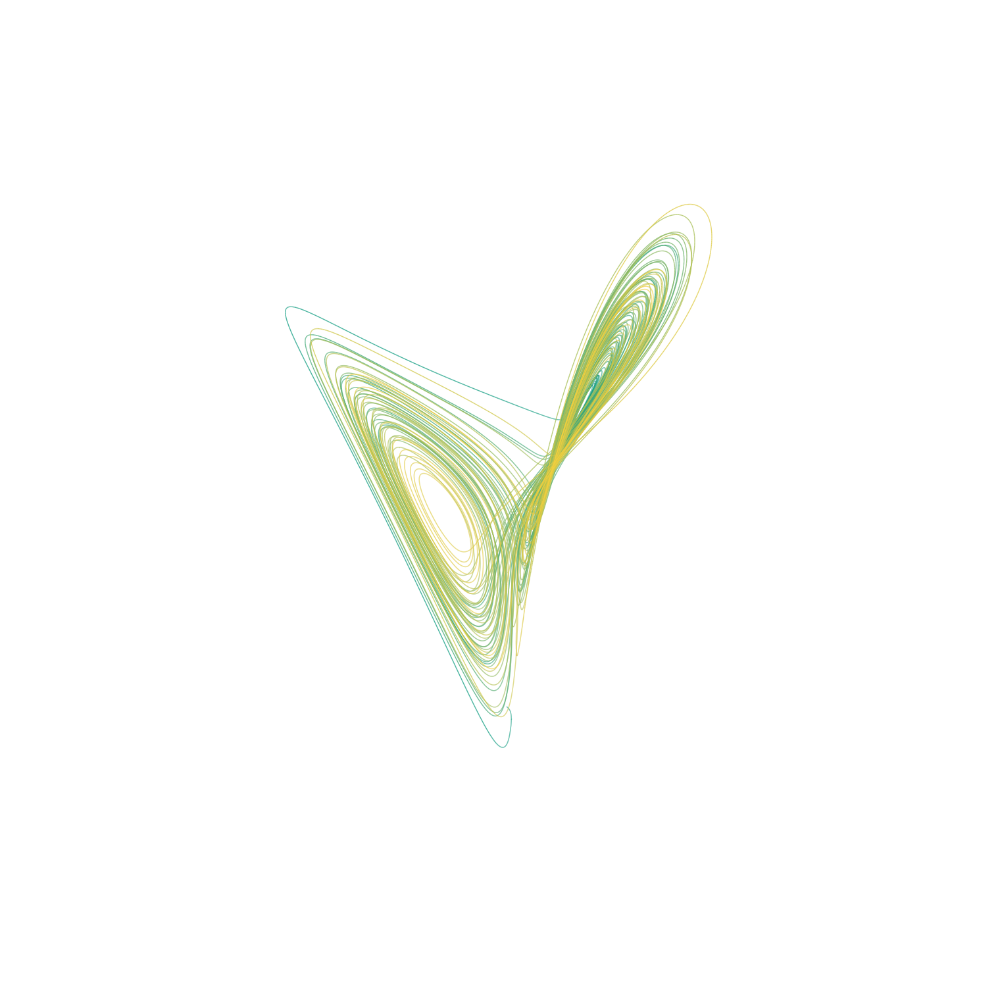

In [15]:
i = -1
_ = plot_3d_trajectory(data, 
                       title=f"3D Trajectory - {viewing_angles[i][0:2]}", 
                       view_angle=viewing_angles[i], 
                       figsize=(30, 15), 
                       colormap=custom_cmap,
                       show_colorbar=False,
                       linewidth=1.0, alpha=0.8, 
                       save_path="./figures/3d_trajectory.pdf", show_title=False)

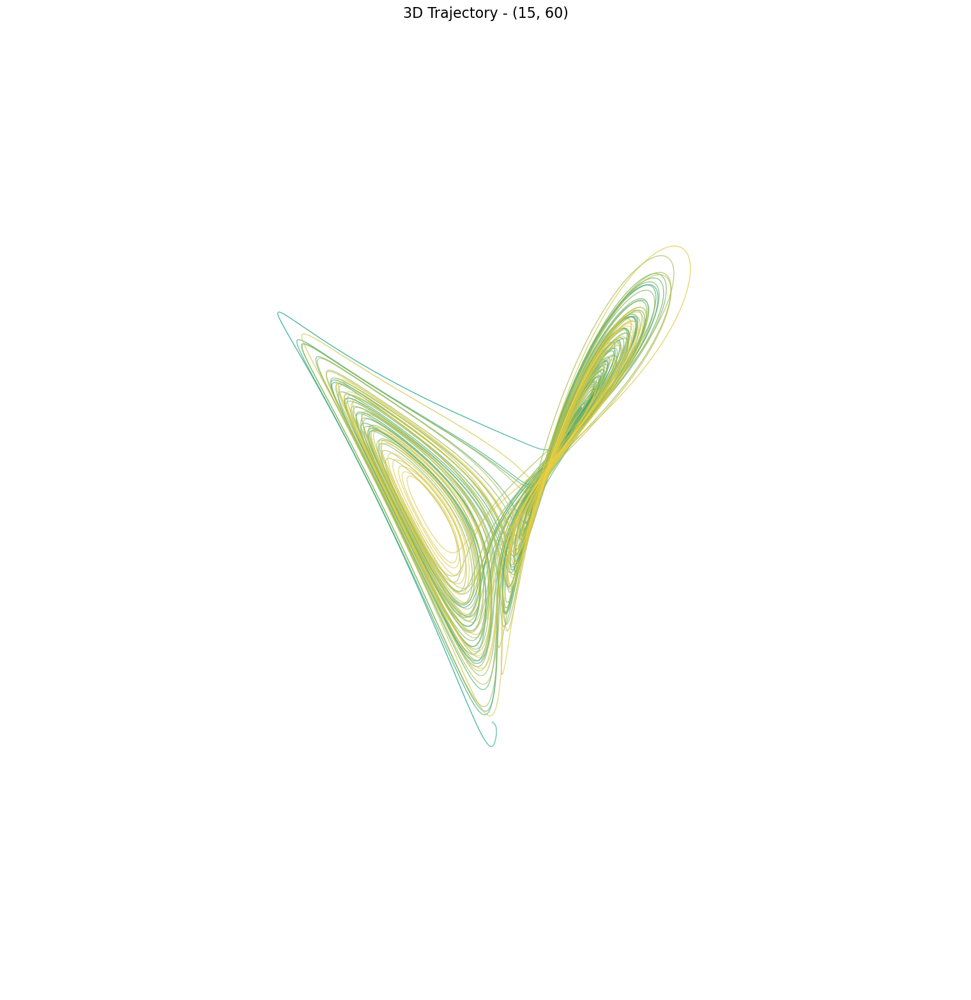

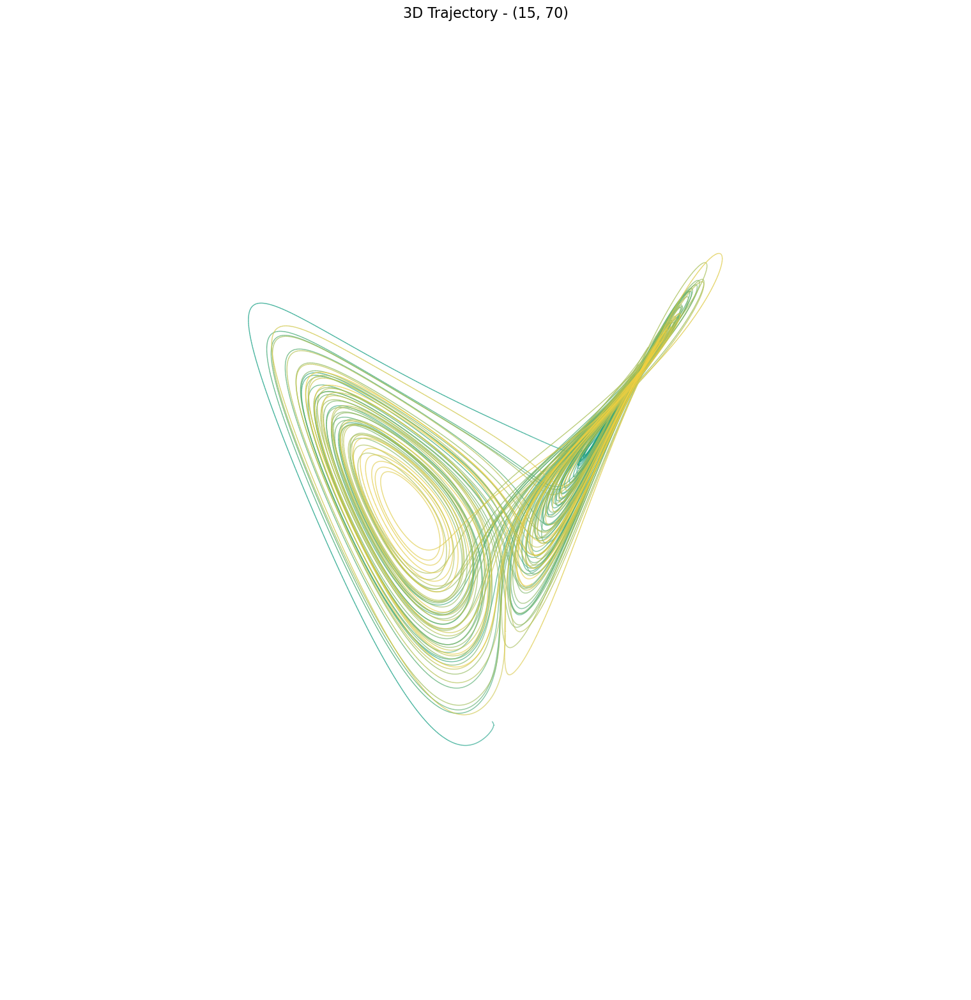

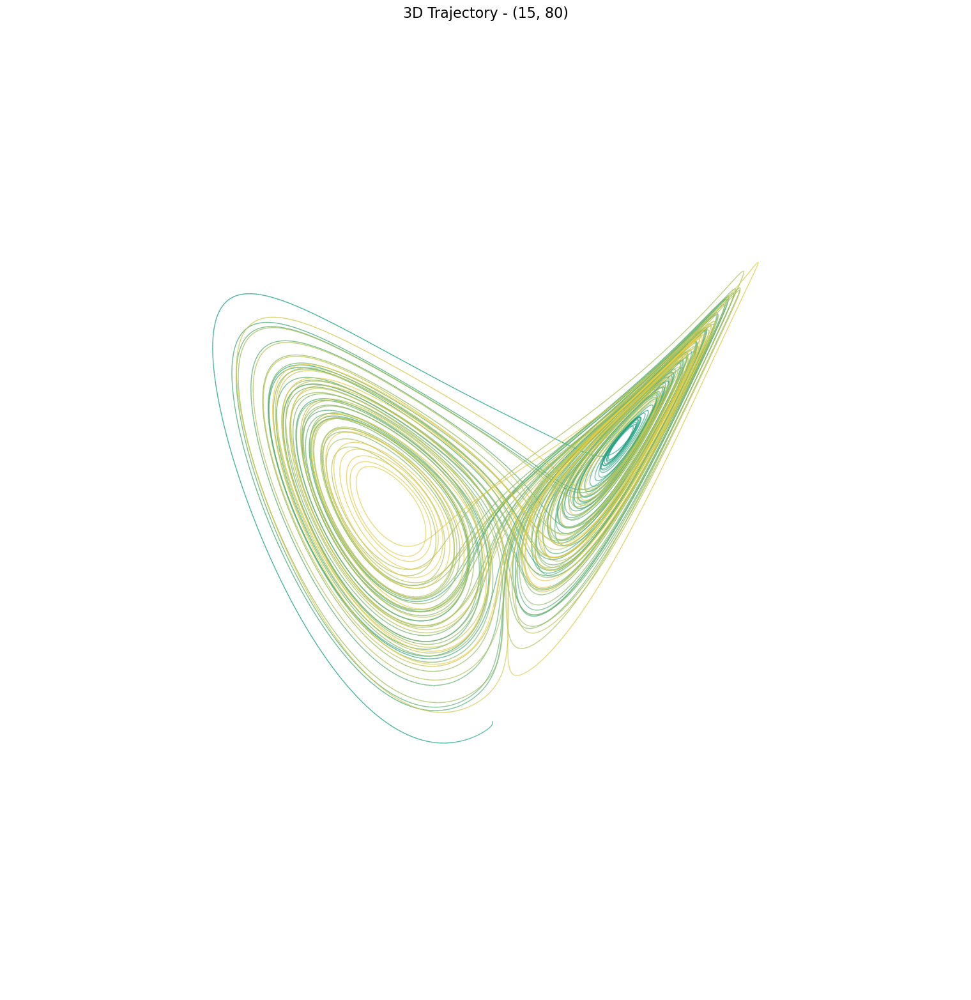

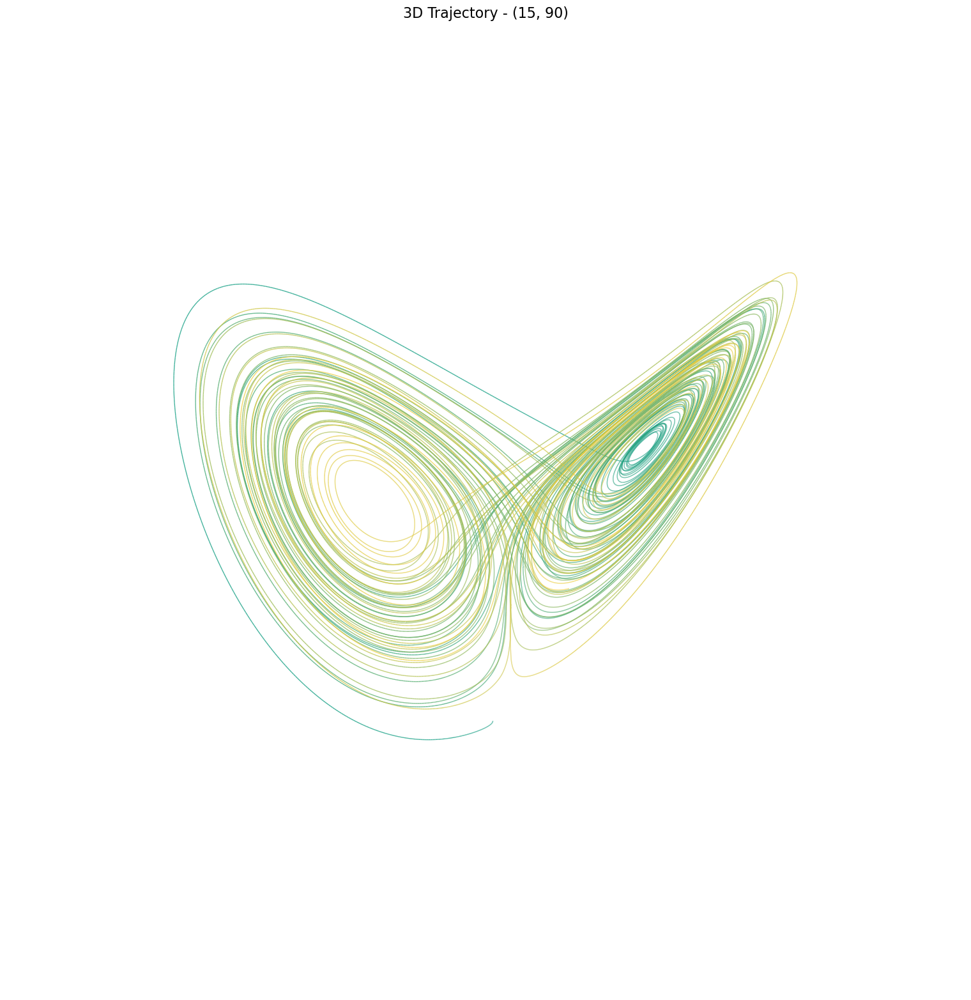

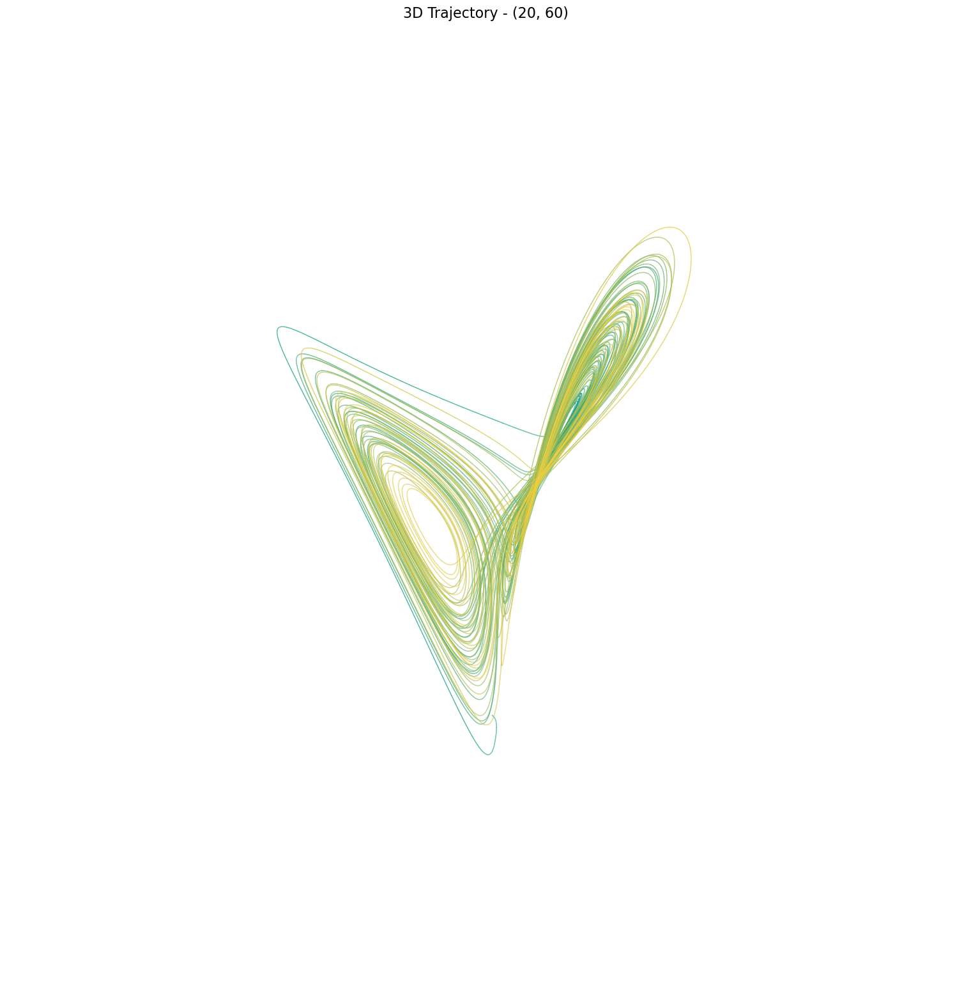

In [16]:
for i in range(len(viewing_angles)):
    plot_3d_trajectory(data, title=f"3D Trajectory - {viewing_angles[i][0:2]}", view_angle=viewing_angles[i], 
                       figsize=(20, 15), colormap=custom_cmap, show_colorbar=False,
                       linewidth=1.0, alpha=0.8, save_path=None)

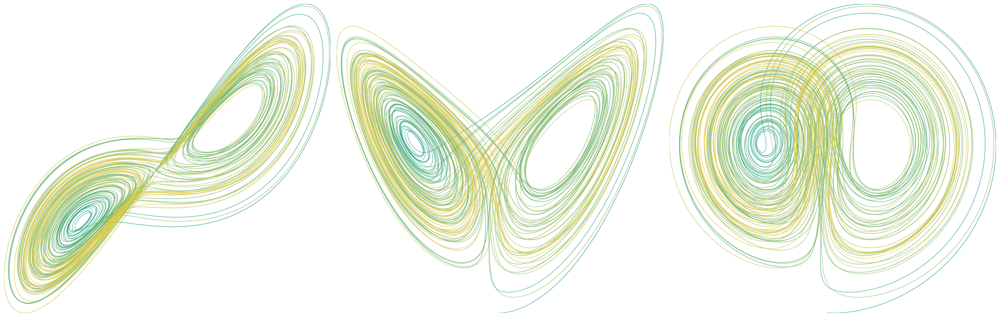

In [17]:
D = 10.0
correlation_time = 5.0

t, x, y, z, eta_x, eta_y, eta_z = lorenz_with_ou_noise(sigma, rho, beta, 
                                  D=D, 
                                  correlation_time=correlation_time,
                                  t_span=t_span, dt=dt, state0=state0)

_ = plot_2d_projections((t, x, y, z),
                        show_labels=False, show_titles=False,  show_colorbar=False, show_main_title=False, 
                        main_title="Stochastic Lorenz System Projections",
                        figsize=(25, 8), colormap=custom_cmap, linewidth=1.0, alpha=0.8, save_path=None,
                        save_subplots_dir="./figures/lorenz_ou_noise_projections_v2"
                        )

In [18]:
# _ = plot_multiple_viewing_angles((t, x, y, z),
#                             title="Stochastic Lorenz System - Multiple Viewing Angles",
#                             figsize=(16, 12), 
#                             colormap=custom_cmap, save_path=None)

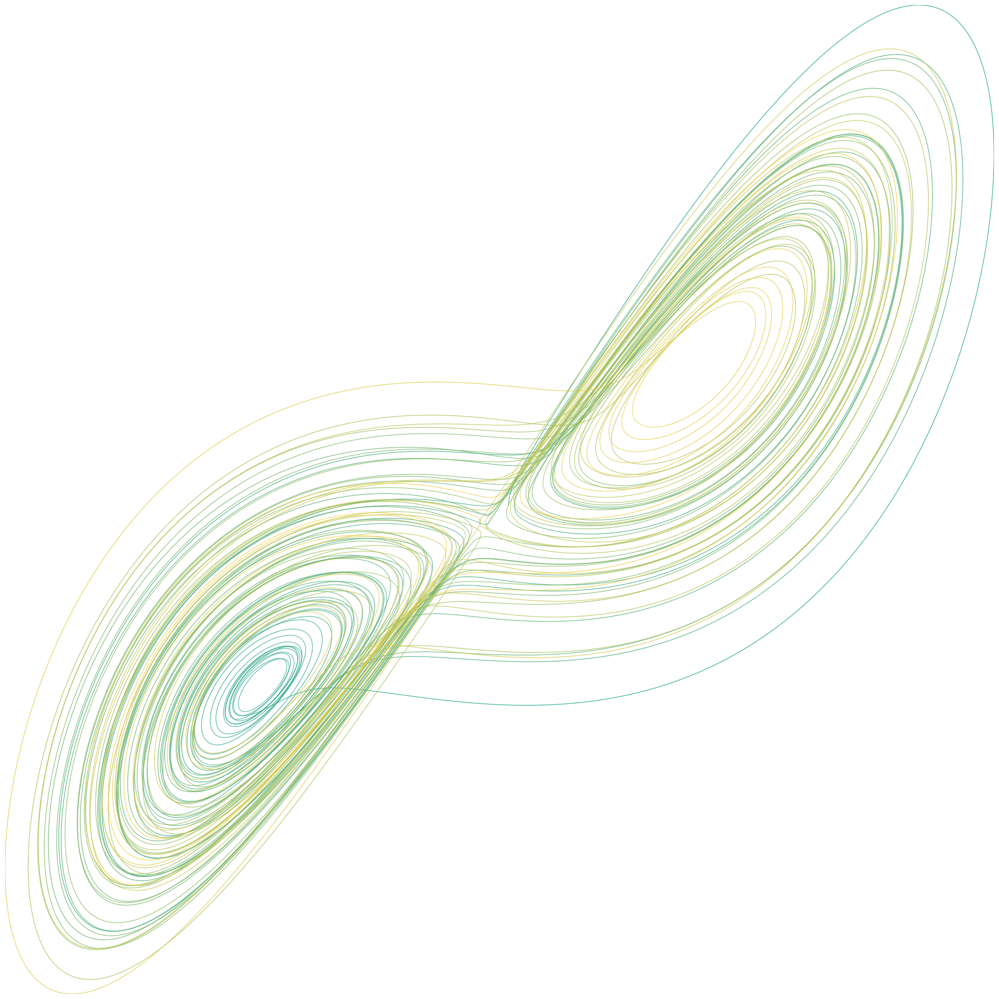

In [19]:
# Plot X-Y projection (index 0)
plot_2d_projection_single(data, projection_index=0, 
                          figsize=(20, 20), 
                          colormap=custom_cmap,
                          save_path="./figures/xy_projection.png")

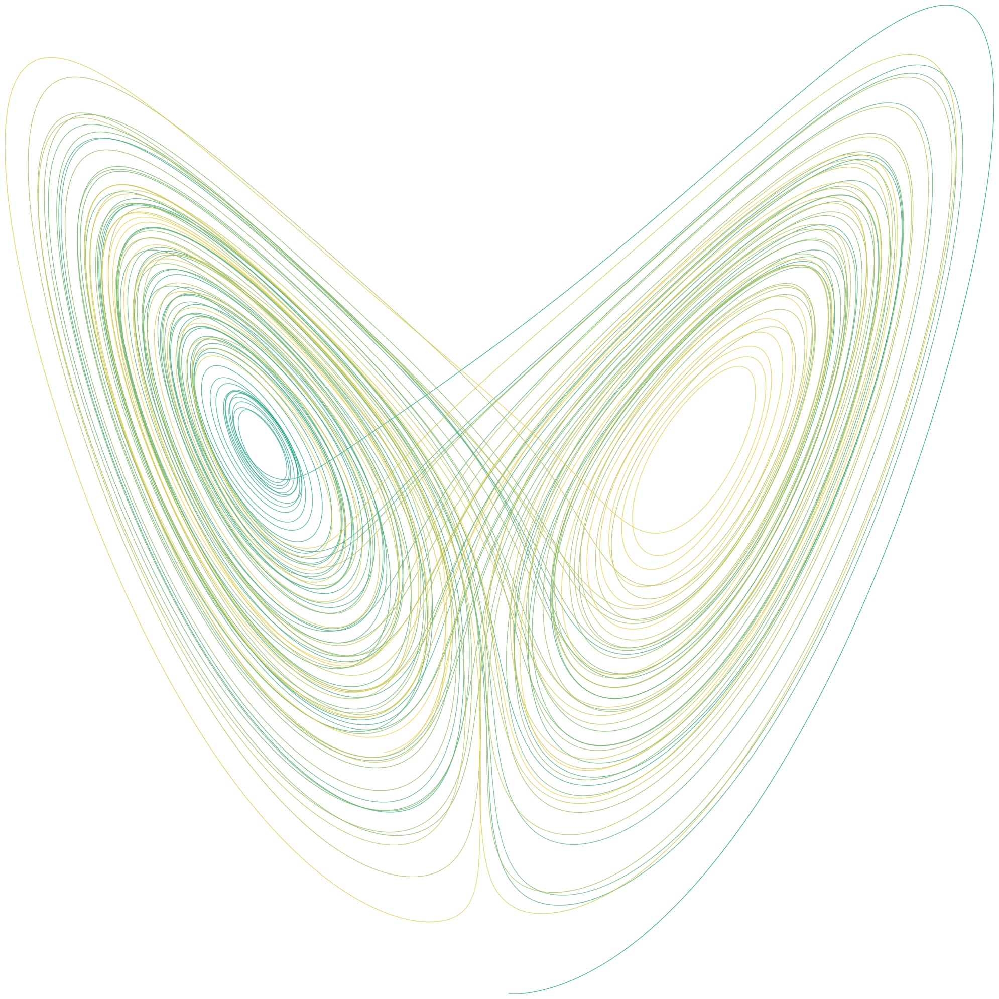

In [20]:

# Plot X-Z projection (index 1)
plot_2d_projection_single(data, projection_index=1, 
                          figsize=(20, 20), 
                          colormap=custom_cmap,
                          save_path="./figures/xz_projection.png")


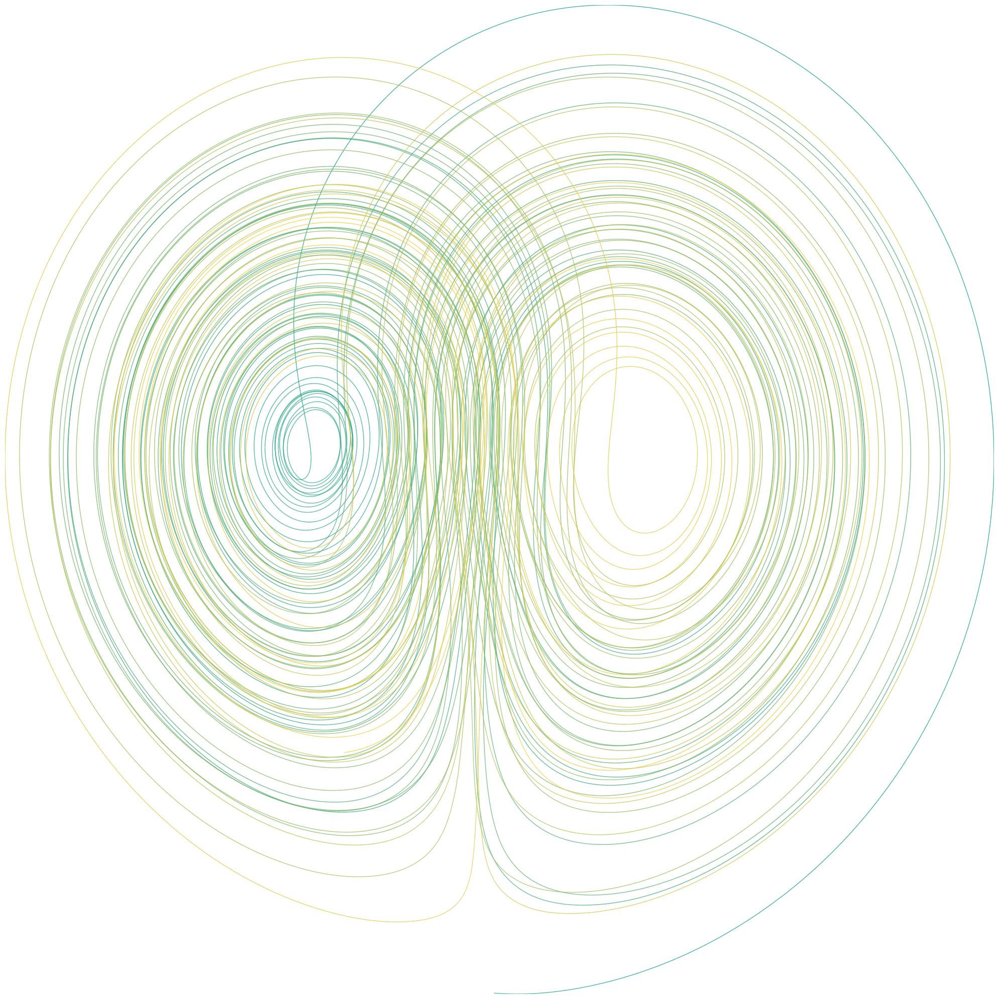

In [21]:

# Plot Y-Z projection (index 2)
plot_2d_projection_single(data, projection_index=2, 
                          figsize=(20, 20), 
                          colormap=custom_cmap,
                          save_path="./figures/yz_projection.png")